In [ ]:
"""
================================================================================
RANDOM FOREST REGRESSION PIPELINE (SINGLE DATASET)
================================================================================
Authors: Giuseppe Riccio, Stefano Cavuoti
Date: 2026-02-24
Description:
    This script performs a Random Forest regression analysis on a single 
    dataset (e.g., 'im2'). It splits the data spatially to predict physical 
    components (CSM, Ejecta) based on image features.
    
    Key functionalities:
    1. Automated band detection and column filtering.
    2. Large-scale data loading using pandas chunks for memory efficiency.
    3. Spatial data splitting (Training on first half, Testing on second half) 
       with a buffer zone (delta) to prevent spatial correlation leakage.
    4. Comprehensive evaluation: Feature Importance (exported to CSV), 
       Residual Statistics, and 2D Spatial Error Mapping.

Dependencies:
    - sklearn (RandomForestRegressor)
    - pandas, numpy, scipy
    - matplotlib, IPython
================================================================================
"""

In [75]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
import numpy as np
import matplotlib.pyplot as plt
import time
import pandas as pd
from scipy.stats import skew, kurtosis
from IPython.display import display, Math, Latex
from copy import copy
import matplotlib.colors as mcolors
%matplotlib inline
plt.rcParams['figure.dpi'] = 300

plt.rcParams["figure.figsize"] = (10,8)


In [76]:
start_time = time.time()

# Function to extract unique bands from the file header
def get_bands_from_file(filename):
    with open(filename, "r") as f:
        header = f.readline().strip()
    columns = header.split(",")
    bands = set()
    for col in columns:
        if col.endswith(("_Ejecta", "_CSM", "_Mask")):
            bands.add(col.split("_")[0])
    return sorted(list(bands))

# Configuration: Select the dataset to analyze
#fname = "im2_AllColumns.csv"
#fname = "im2_AllColumns_onlyHaar.csv"
#fname = "im2_AllColumns_onlyHaar_10r.csv"
#fname = "im2_AllColumns_onlyHaralick.csv"
#fname = "im2_best10feat_CSM.csv"
#fname = "im2_best10feat_Ejecta.csv"
#fname = "im2_best20feat_CSM.csv"
#fname = "im2_best20feat_Ejecta.csv"

fname = "im2_best3feat_CSM.csv"
#fname = "im2_best3feat_Ejecta.csv"
#fname = "im2_best5feat_CSM.csv"
#fname = "im2_best5feat_Ejecta.csv"
                              


bands = get_bands_from_file(fname)
print(f"Detected Bands: {bands}")

# Read the header to map columns
with open(fname, "r") as hdrReader:
    hdr = hdrReader.readline().strip()
hdrBites = hdr.split(",")

# Generate list of target features and masks to exclude from training features (X)
featExcluded = [f"{band}_{suffix}" for band in bands for suffix in ["Ejecta", "CSM", "Mask"]]

# Create column index lists and exclusion dictionaries
collist = []
hdrBites2 = []
dictEx = {}
for i, column in enumerate(hdrBites):
    if column in featExcluded:
        print(f"{i}, {column}, excluded")
        dictEx[column] = i
    else:
        collist.append(i)
        hdrBites2.append(column)

# Efficient data loading using chunks
                  
                                                                                
chunk = pd.read_csv(fname, chunksize=1000)
fulldata = pd.concat(chunk)
                                                     
t_check = time.time() - start_time
print(f"Loading time: {round(t_check, 3)} seconds")

Bande rilevate: ['0512norm', '1216norm', '1621norm', '2130norm', '3035norm', '3540norm', '4050norm', '5060norm', '6070norm', '7080norm']
1, 0512norm_Ejecta, excluded
2, 0512norm_CSM, excluded
3, 0512norm_Mask, excluded
5, 1216norm_Ejecta, excluded
6, 1216norm_CSM, excluded
7, 1216norm_Mask, excluded
9, 1621norm_Ejecta, excluded
10, 1621norm_CSM, excluded
11, 1621norm_Mask, excluded
13, 2130norm_Ejecta, excluded
14, 2130norm_CSM, excluded
15, 2130norm_Mask, excluded
17, 3035norm_Ejecta, excluded
18, 3035norm_CSM, excluded
19, 3035norm_Mask, excluded
21, 3540norm_Ejecta, excluded
22, 3540norm_CSM, excluded
23, 3540norm_Mask, excluded
25, 4050norm_Ejecta, excluded
26, 4050norm_CSM, excluded
27, 4050norm_Mask, excluded
29, 5060norm_Ejecta, excluded
30, 5060norm_CSM, excluded
31, 5060norm_Mask, excluded
33, 6070norm_Ejecta, excluded
34, 6070norm_CSM, excluded
35, 6070norm_Mask, excluded
37, 7080norm_Ejecta, excluded
38, 7080norm_CSM, excluded
39, 7080norm_Mask, excluded
--- 3.041 seconds --

In [77]:
tstart = time.time()
# Select only the feature columns for Xtotal
Xtotal = fulldata[hdrBites2].to_numpy()

t_check_1 = time.time() - tstart
print(f"Selection time: {round(t_check_1, 3)} seconds")

--- 0.071 seconds ---


In [78]:
tstart = time.time()
# Mask creation: process mask columns for all bands
masks = {}
for band in bands:
    col_mask = f"{band}_Mask"
    masks[band] = fulldata[col_mask].to_numpy(dtype=str)

# Combine masks: include points only where all band masks are False
maskTotBol = np.ones(len(masks[bands[0]]), dtype=bool)
for mask in masks.values():
    maskTotBol &= (mask != "True")    
    
t_check_2 = time.time() - tstart
print(f"Mask processing time: {round(t_check_2, 3)} seconds")

--- 0.734 seconds ---


In [79]:
tstart = time.time()
# Spatial data splitting
delta = 512 # Buffer zone to separate Train and Test sets
idtotal = np.arange(Xtotal.shape[0])
mid = int(idtotal.shape[0] / 2)

# Training on the first half (excluding buffer), Testing on the second half (excluding buffer)
idtrain = idtotal[:mid-delta][maskTotBol[:mid-delta]]
idtest = idtotal[mid+delta:][maskTotBol[mid+delta:]]

Xtrain = Xtotal[:mid-delta,:][maskTotBol[:mid-delta]]
Xtest = Xtotal[mid+delta:,:][maskTotBol[mid+delta:]]

t_check_3 = time.time() - tstart
print(f"Data split time: {round(t_check_3, 3)} seconds")

--- 0.011 seconds ---


In [80]:
def train_and_analyze(X_train, X_test, y_train, y_test, target_name):
    """Trains Random Forest and generates analytical plots and stats."""
    start_time = time.time()
    
    # Model Training
    regr = RandomForestRegressor(n_estimators=100, n_jobs=8, random_state=7182)
                                                                                 
    regr.fit(X_train, y_train)
                                                                                        
    
    # Prediction
    y_predict = regr.predict(X_test)
                                                                                     
    importances = regr.feature_importances_

    # Calculate standard deviation of importances across trees

                                           

    std = np.std([tree.feature_importances_ for tree in regr.estimators_], axis=0)
    
    # Export feature importance to CSV
    forest_importances = pd.DataFrame({"importance" : importances, "std" : std}, index=(hdrBites2))
    forest_importances.index.name = "feature"
    forest_importances = forest_importances.sort_values("importance", ascending=False)
    forest_importances.to_csv("feature_importance_"+target_name+".csv")
    
    
    print(forest_importances.head(100))
    
    # Plot: Predicted vs Real Values
                                                 
                                        
                                
                                          

                       
                

                                                   
    plt.figure(figsize=(10, 8))
    plt.scatter(y_test, y_predict, s=0.1)
    plt.plot([0, .5], [0, .5], c="r", linestyle='dashed')
    plt.xlabel(f"{target_name} Real Value")
    plt.ylabel(f"{target_name} Predicted Value")
    plt.title(f"Predictions vs Real Values for {target_name}")
    plt.show()
    
    # Statistical Analysis of Residuals (Delta)

    delta = y_test - y_predict
    mean_delta = np.mean(delta)
    std_delta = np.std(delta)
    skewness_delta = skew(delta)
    kurtosis_delta = kurtosis(delta)
    median_delta = np.median(delta)
    percentile_25 = np.percentile(delta, 25)
    percentile_75 = np.percentile(delta, 75)
    iqr_delta = percentile_75 - percentile_25
    min_delta = np.min(delta)
    max_delta = np.max(delta)

    print(f"{'Statistics':<20} {'Value':>10}")
    print("-" * 31)
    print(f"{'Mean:':<20} {mean_delta:>10.6f}")
    print(f"{'Std Deviation:':<20} {std_delta:>10.6f}")
    print(f"{'Skewness:':<20} {skewness_delta:>10.6f}")
    print(f"{'Kurtosis:':<20} {kurtosis_delta:>10.6f}")
    print(f"{'Median:':<20} {median_delta:>10.6f}")
    print(f"{'25th Percentile:':<20} {percentile_25:>10.6f}")
    print(f"{'75th Percentile:':<20} {percentile_75:>10.6f}")
    print(f"{'IQR:':<20} {iqr_delta:>10.6f}")
    print(f"{'Min Value:':<20} {min_delta:>10.6f}")
    print(f"{'Max Value:':<20} {max_delta:>10.6f}")
    
    # Plot: Total Flux vs Real Values
    
                                                    
    plt.figure()
    plt.scatter(y_test, X_test[:, 0], s=0.1)
    plt.plot([0, .5], [0, .5], c="r", linestyle='dashed')
    plt.xlabel(f"{target_name} Real Value")
    plt.ylabel(f"{target_name.split('_')[0]} Total Value")
    plt.title(f"Total Values vs Real Values for {target_name}")
    plt.show()

    # Spatial Error Map
    #     coord_x_test = idtest // 512
    coord_y_test = idtest % 512
    new_img = -1*np.ones((512, 512))
    new_img[coord_x_test, coord_y_test] = y_test - y_predict
    masked_array = np.ma.masked_where(new_img == -1, new_img)
    cmap = plt.cm.tab20  
    
                                                                            
    
    cmap.set_bad(color='white')

    
    plt.figure(figsize=(10, 8))
    plt.matshow(masked_array, fignum=1, cmap=cmap)
    plt.colorbar(extend='max', spacing='proportional')
    plt.title(f"Error Map for {target_name}")
    plt.show()


<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 0512norm_CSM

********************************************************************************


                              importance       std
feature                                           
4050norm_Total                  0.350361  0.286847
5060norm_Total                  0.338562  0.287599
0512norm_Total                  0.253029  0.002543
3540norm_Total                  0.010065  0.000863
2130norm_Total                  0.009246  0.000684
1621norm_Total                  0.008408  0.001423
3035norm_Total                  0.005358  0.000473
7080norm_haar_2x_8              0.005198  0.002692
7080norm_haar_2x_7              0.004335  0.002449
7080norm_haar_2y_4_flip         0.004229  0.001699
7080norm_Total                  0.003742  0.000276
1216norm_Total                  0.002618  0.000618
6070norm_Total                  0.001557  0.000159
2130norm_haralick_r4_mean_f3    0.001

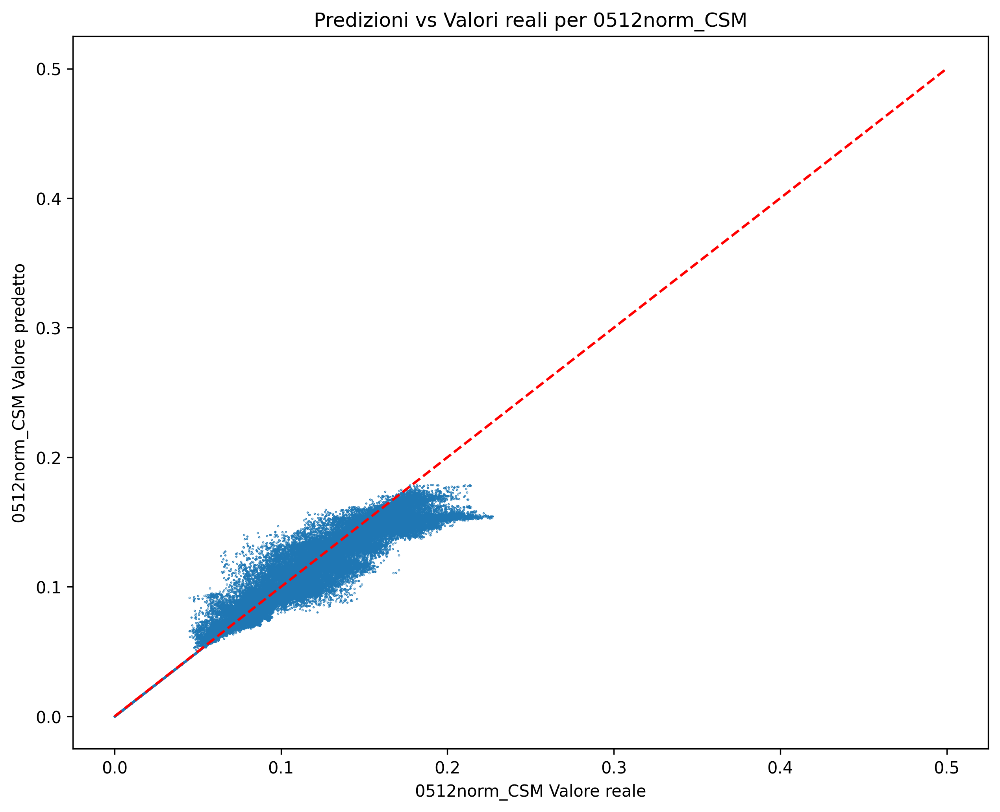

Statistiche              Valore
-------------------------------
Media:                 0.004398
Deviazione Standard:   0.012013
Skewness:              0.940335
Kurtosis:              3.534172
Mediana:               0.001392
25° Percentile:       -0.000028
75° Percentile:        0.008365
IQR:                   0.008392
Valore Minimo:        -0.062440
Valore Massimo:        0.073633


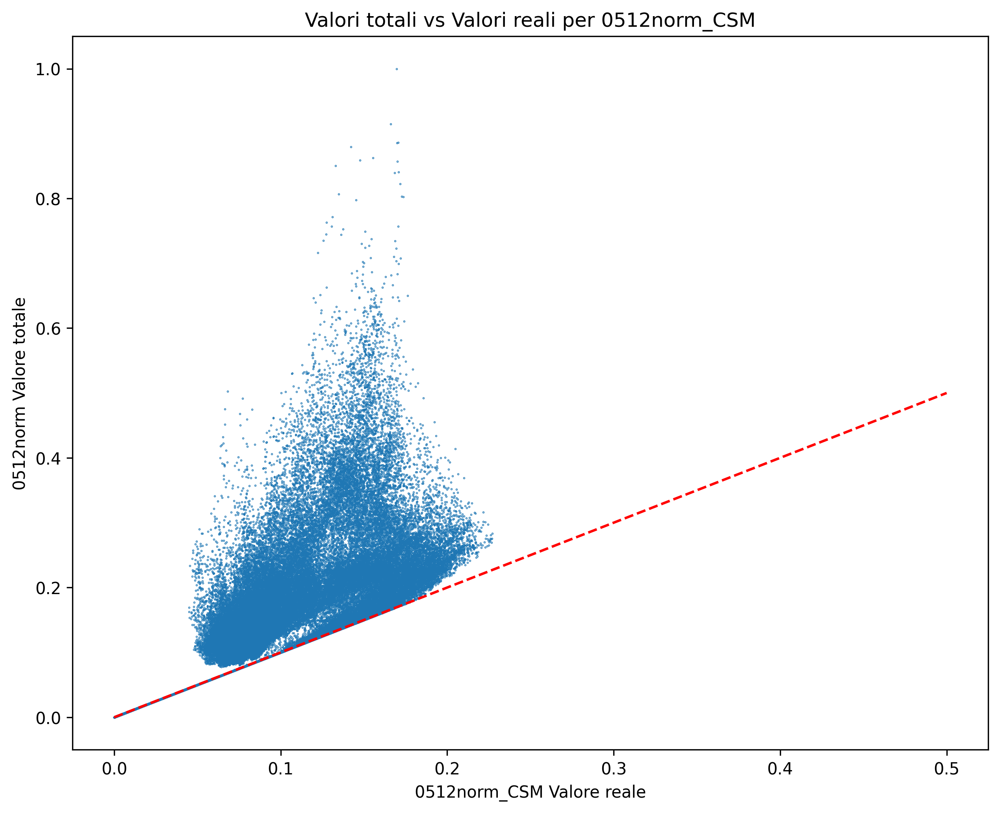

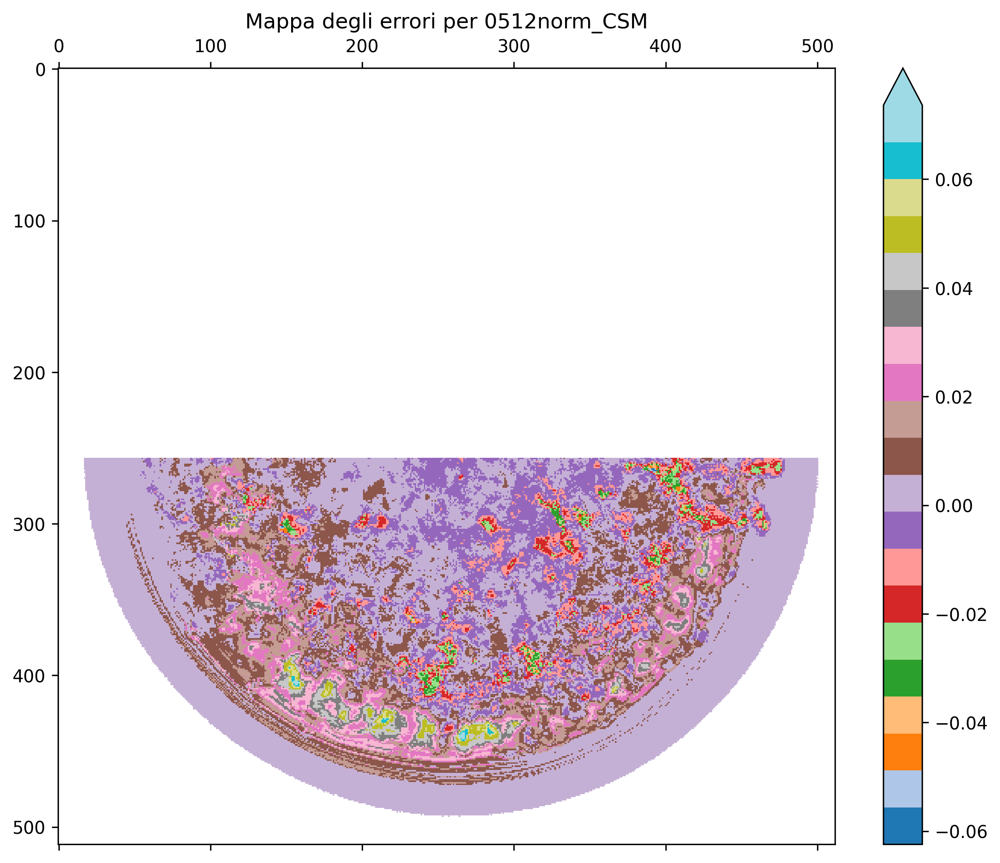

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 1216norm_CSM

********************************************************************************


                              importance       std
feature                                           
4050norm_Total                  0.726672  0.004196
1216norm_Total                  0.215207  0.002911
0512norm_Total                  0.011182  0.000434
2130norm_Total                  0.010563  0.000915
3540norm_Total                  0.009865  0.001585
3035norm_Total                  0.006537  0.000804
7080norm_haar_2x_8              0.003467  0.001298
7080norm_haar_2x_7              0.003407  0.001332
7080norm_Total                  0.003004  0.000226
1621norm_Total                  0.002421  0.000918
7080norm_haar_2y_4_flip         0.002220  0.000878
5060norm_Total                  0.001478  0.002490
6070norm_Total                  0.001292  0.000165
2130norm_haralick_r4_mean_f3    0.001

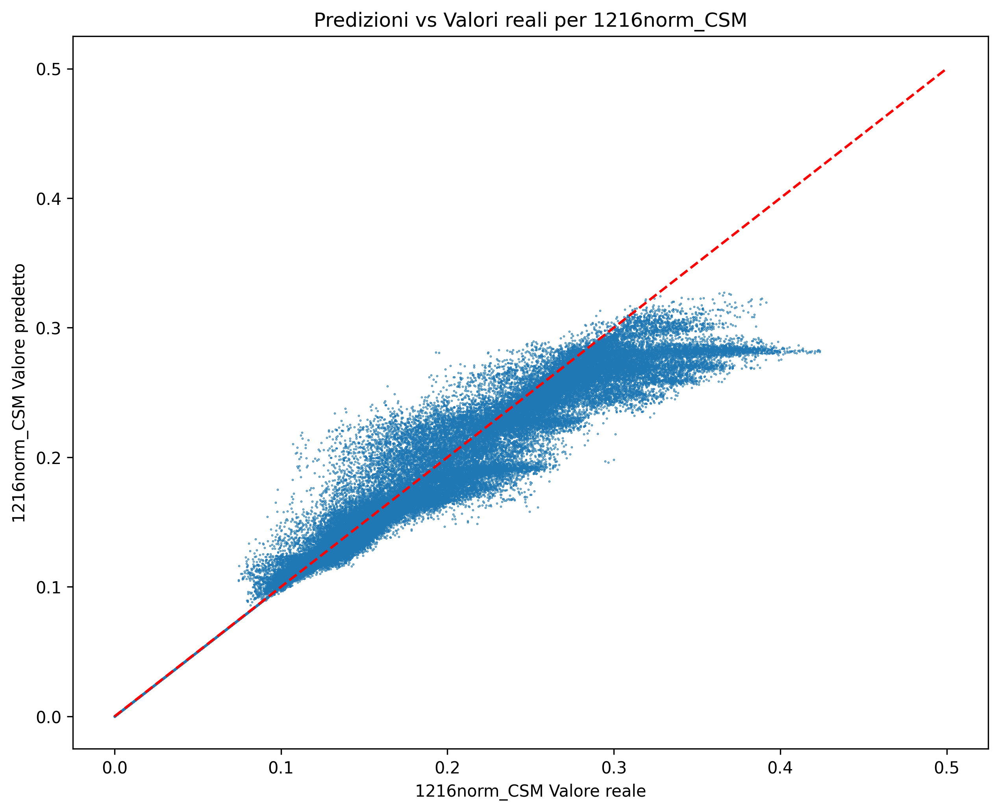

Statistiche              Valore
-------------------------------
Media:                 0.007504
Deviazione Standard:   0.021057
Skewness:              1.152211
Kurtosis:              4.558825
Mediana:               0.002112
25° Percentile:       -0.000010
75° Percentile:        0.012853
IQR:                   0.012864
Valore Minimo:        -0.106409
Valore Massimo:        0.142364


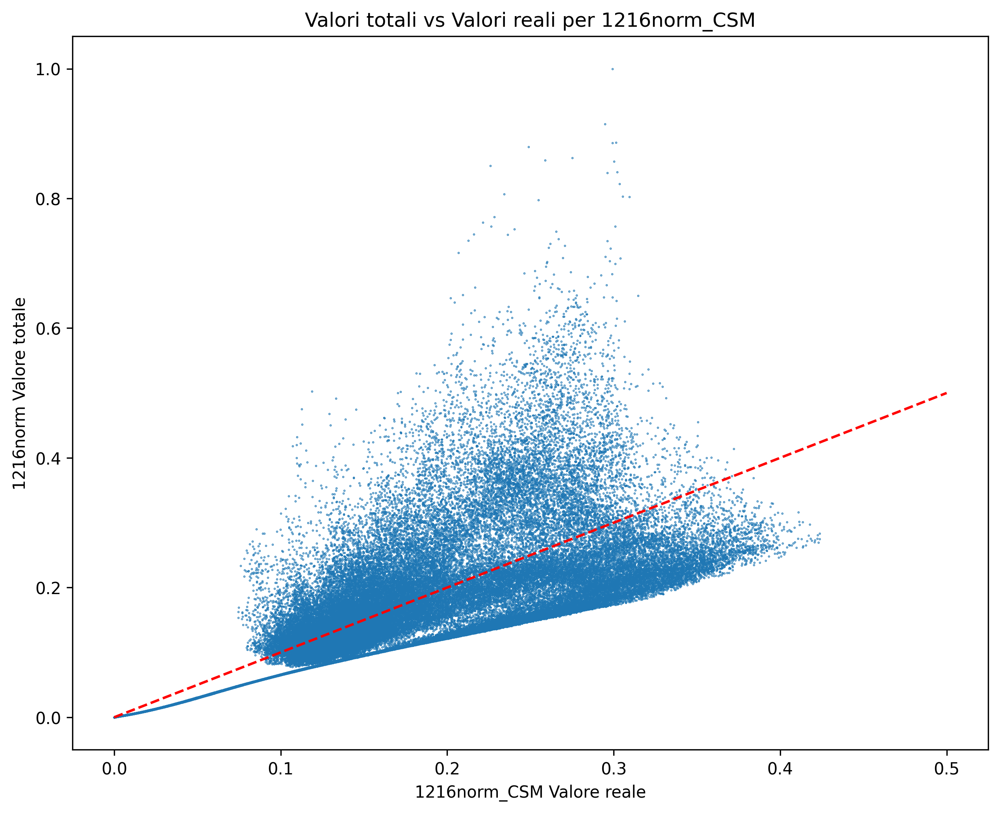

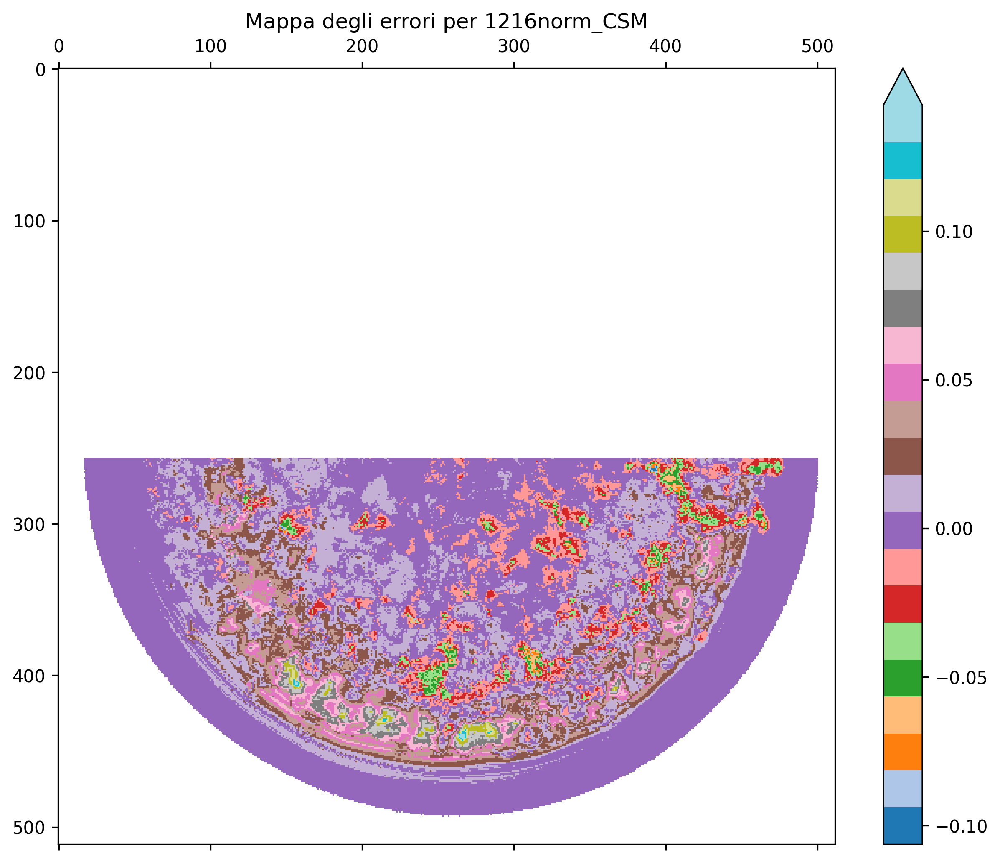

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 1621norm_CSM

********************************************************************************


                              importance       std
feature                                           
5060norm_Total                  0.595457  0.118911
1621norm_Total                  0.220658  0.003037
4050norm_Total                  0.131343  0.119755
2130norm_Total                  0.010785  0.000946
0512norm_Total                  0.010349  0.000423
3540norm_Total                  0.009317  0.001355
3035norm_Total                  0.005478  0.000732
7080norm_haar_2x_8              0.003227  0.001418
7080norm_haar_2x_7              0.002704  0.001243
7080norm_haar_2y_4_flip         0.002524  0.000971
7080norm_Total                  0.002450  0.000235
1216norm_Total                  0.001758  0.000248
2130norm_haralick_r4_mean_f3    0.001333  0.000150
6070norm_Total                  0.001

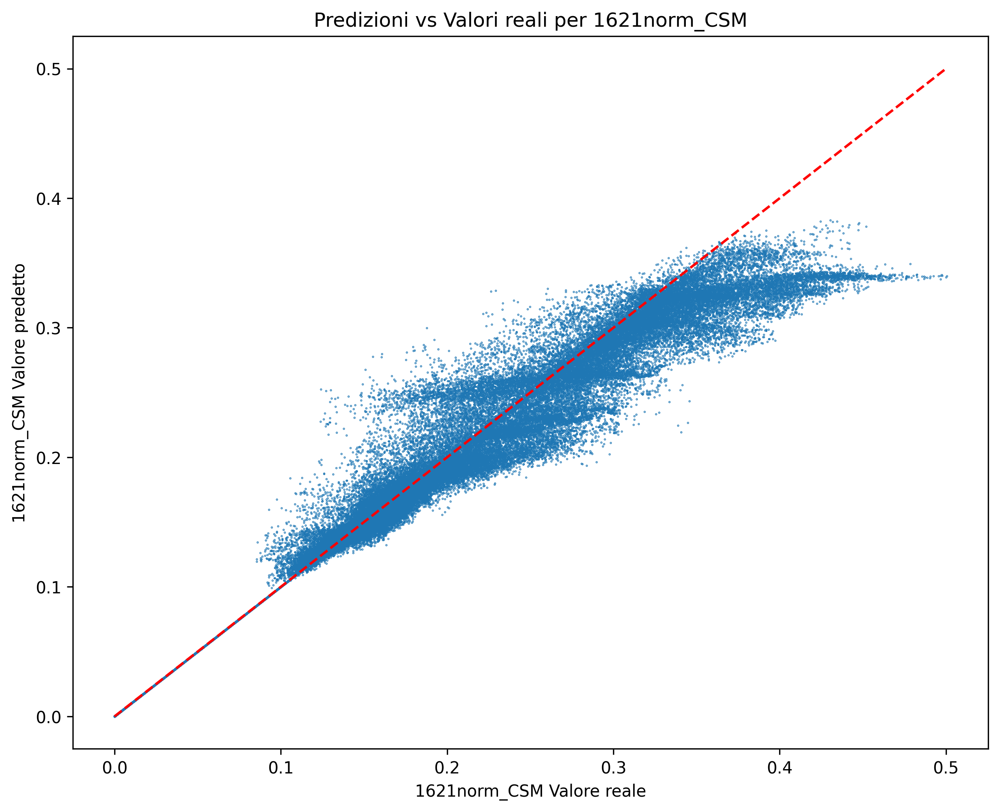

Statistiche              Valore
-------------------------------
Media:                 0.007884
Deviazione Standard:   0.023076
Skewness:              0.901429
Kurtosis:              4.448765
Mediana:               0.002378
25° Percentile:       -0.000014
75° Percentile:        0.014134
IQR:                   0.014148
Valore Minimo:        -0.128294
Valore Massimo:        0.160895


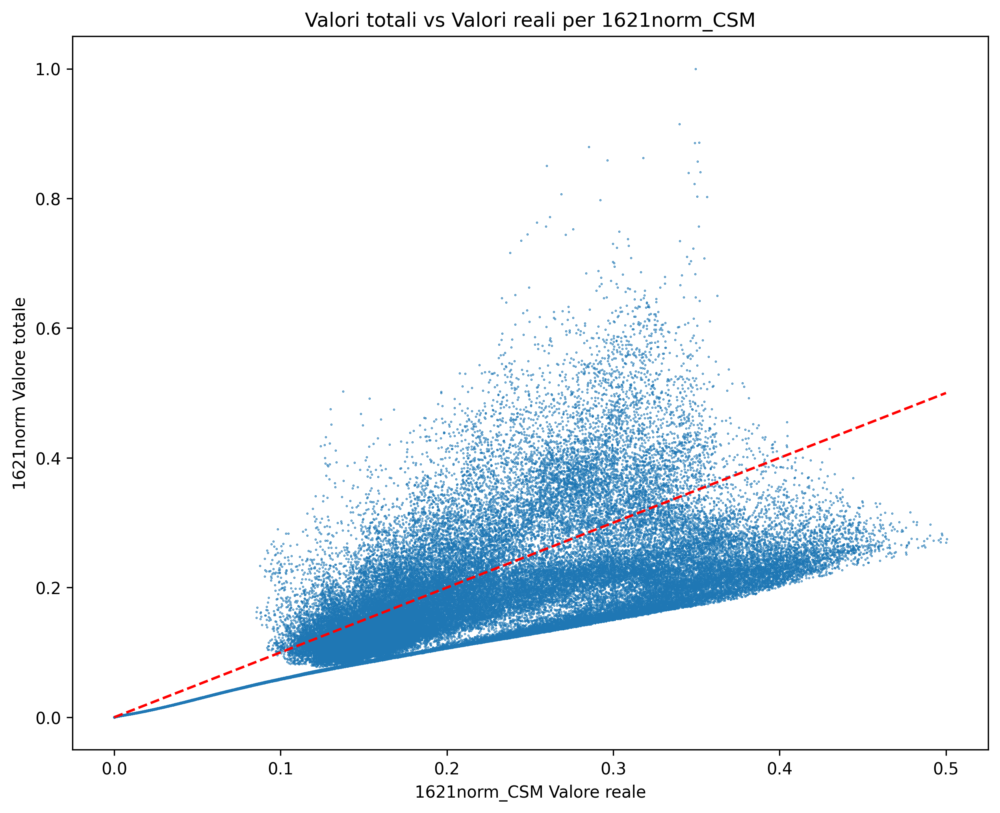

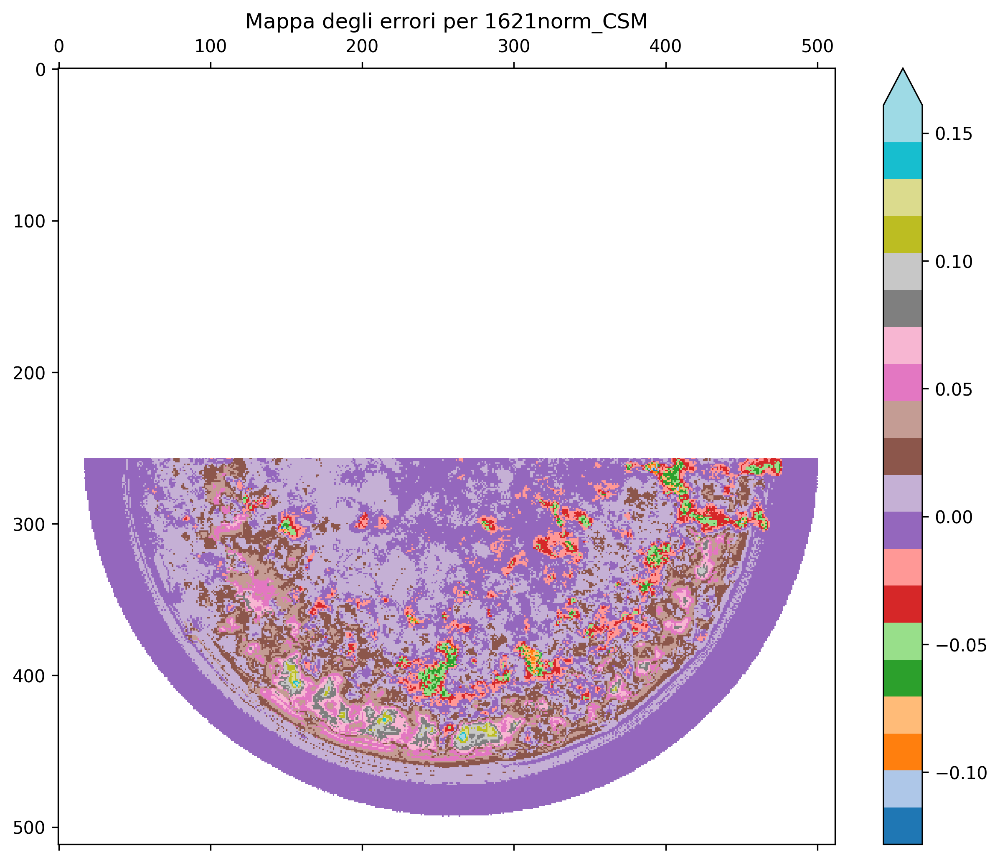

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 2130norm_CSM

********************************************************************************


                              importance       std
feature                                           
5060norm_Total                  0.707992  0.005757
2130norm_Total                  0.222750  0.004547
4050norm_Total                  0.031900  0.002646
0512norm_Total                  0.009450  0.000354
3540norm_Total                  0.007440  0.001598
3035norm_Total                  0.003523  0.000656
7080norm_haar_2y_4_flip         0.002771  0.000879
7080norm_haar_2x_8              0.002608  0.001079
7080norm_haar_2x_7              0.002492  0.001146
1621norm_Total                  0.002474  0.000924
7080norm_Total                  0.001753  0.000194
1216norm_Total                  0.001269  0.000172
2130norm_haralick_r4_mean_f3    0.001213  0.000105
6070norm_Total                  0.001

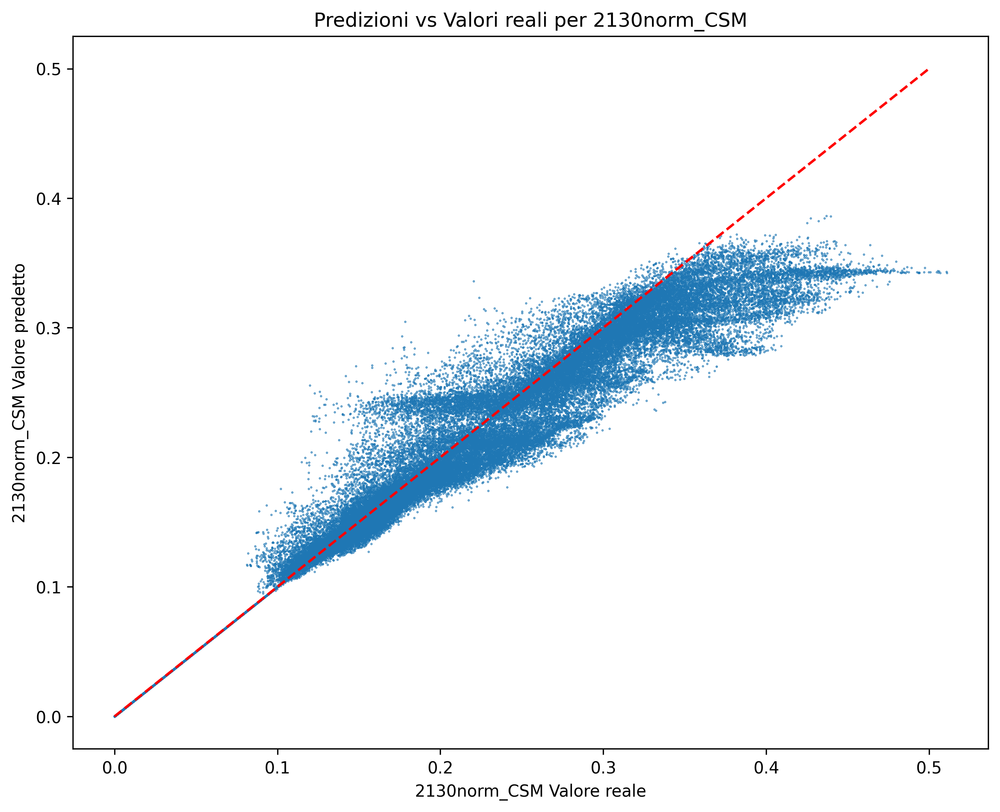

Statistiche              Valore
-------------------------------
Media:                 0.008160
Deviazione Standard:   0.023617
Skewness:              1.051715
Kurtosis:              4.883496
Mediana:               0.002278
25° Percentile:       -0.000007
75° Percentile:        0.013637
IQR:                   0.013644
Valore Minimo:        -0.135653
Valore Massimo:        0.168351


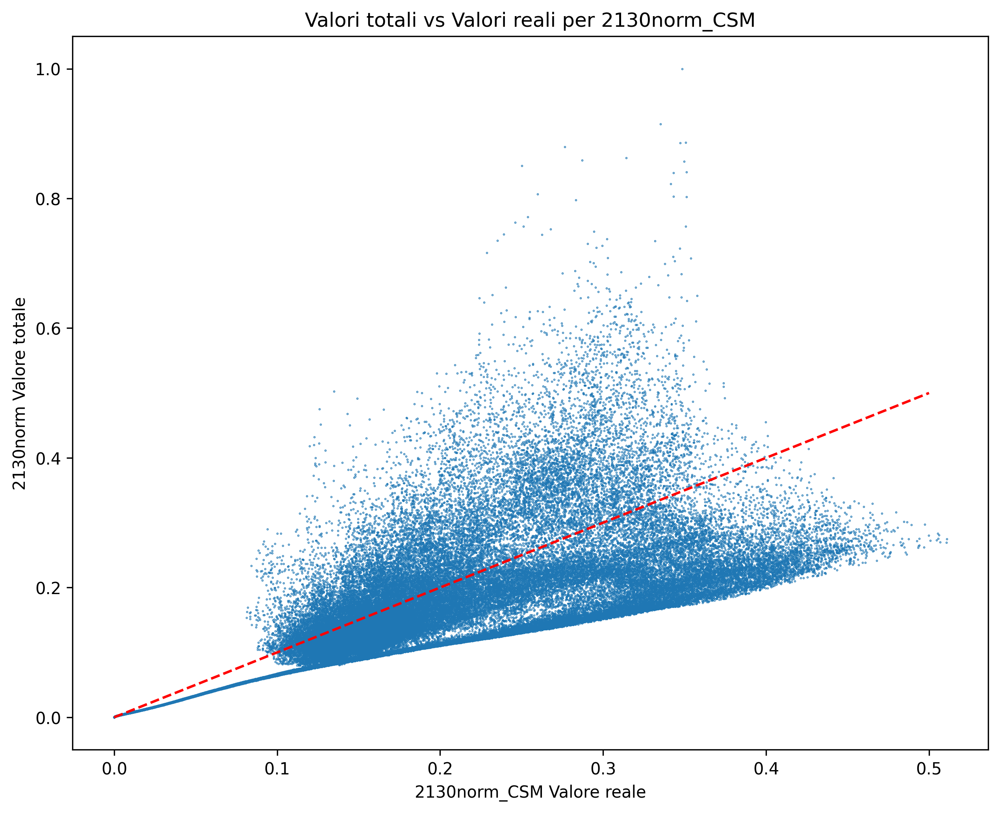

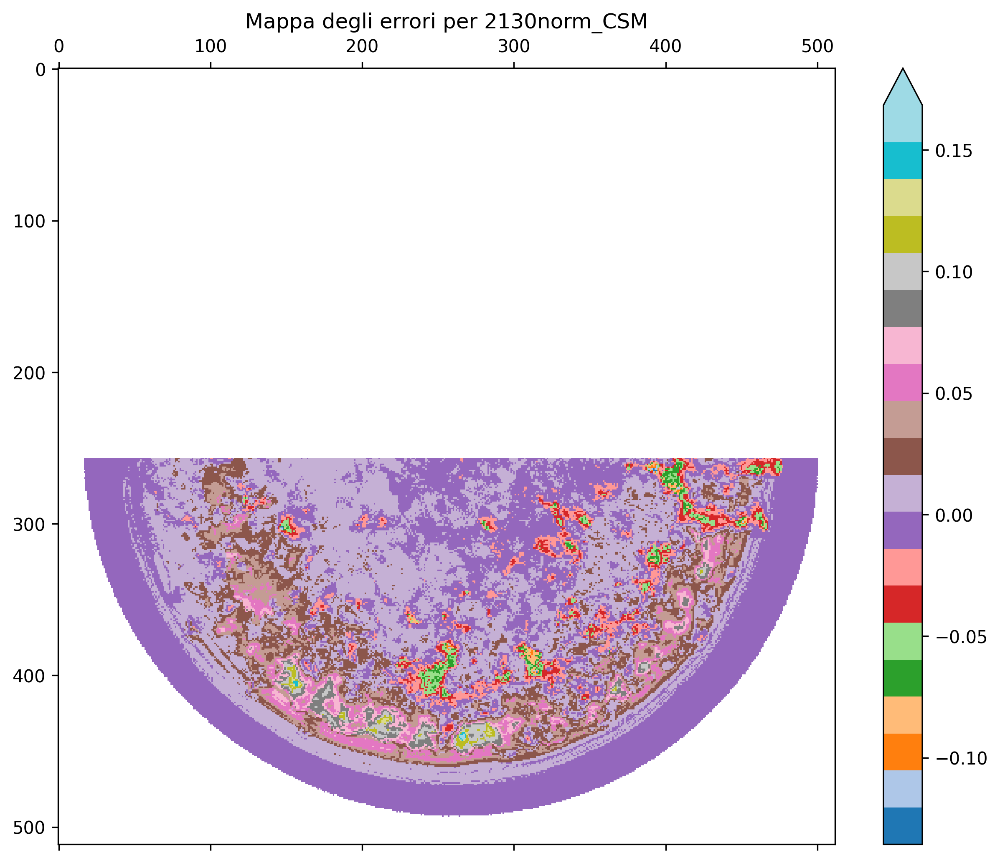

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 3035norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.531144  0.213855
3035norm_Total                  0.216222  0.003512
5060norm_Total                  0.174793  0.208108
4050norm_Total                  0.030591  0.003840
0512norm_Total                  0.010089  0.000341
2130norm_Total                  0.010083  0.000723
6070norm_Total                  0.007183  0.061464
3540norm_Total                  0.006706  0.001174
1621norm_Total                  0.003166  0.000859
7080norm_haar_2y_4_flip         0.002755  0.000685
7080norm_haar_2x_8              0.002150  0.000774
7080norm_haar_2x_7              0.001701  0.000635
1216norm_Total                  0.001278  0.000213
2130norm_haralick_r4_mean_f3    0.001

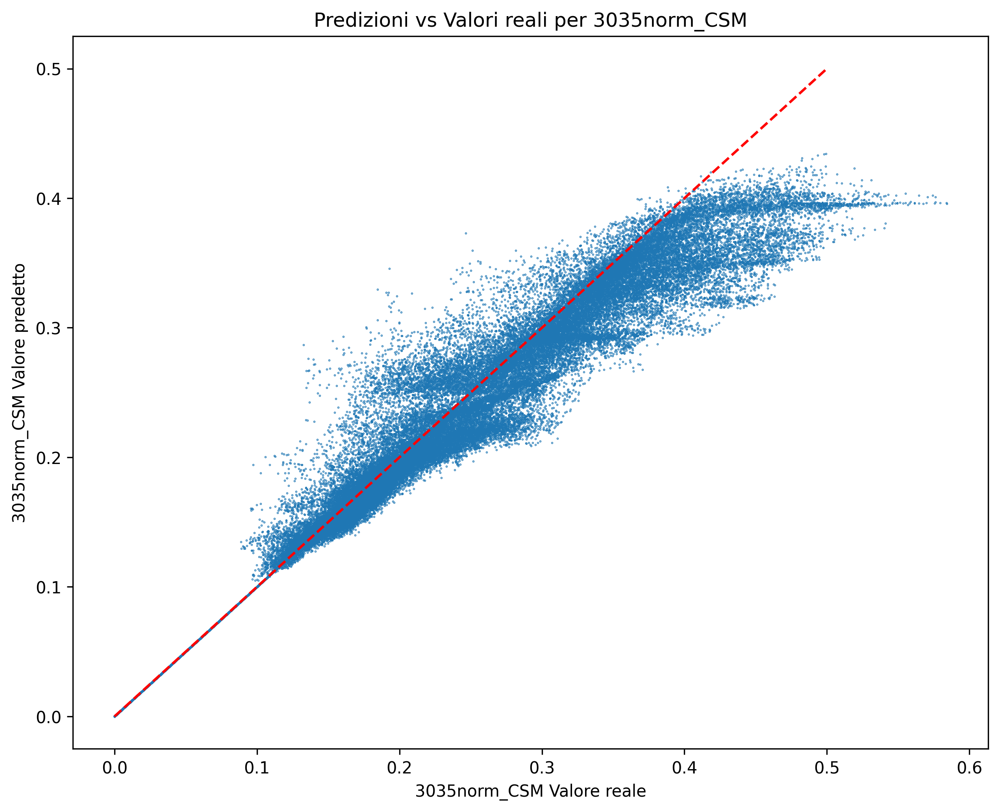

Statistiche              Valore
-------------------------------
Media:                 0.008941
Deviazione Standard:   0.025652
Skewness:              1.106511
Kurtosis:              5.361835
Mediana:               0.002551
25° Percentile:       -0.000005
75° Percentile:        0.014697
IQR:                   0.014701
Valore Minimo:        -0.154252
Valore Massimo:        0.188281


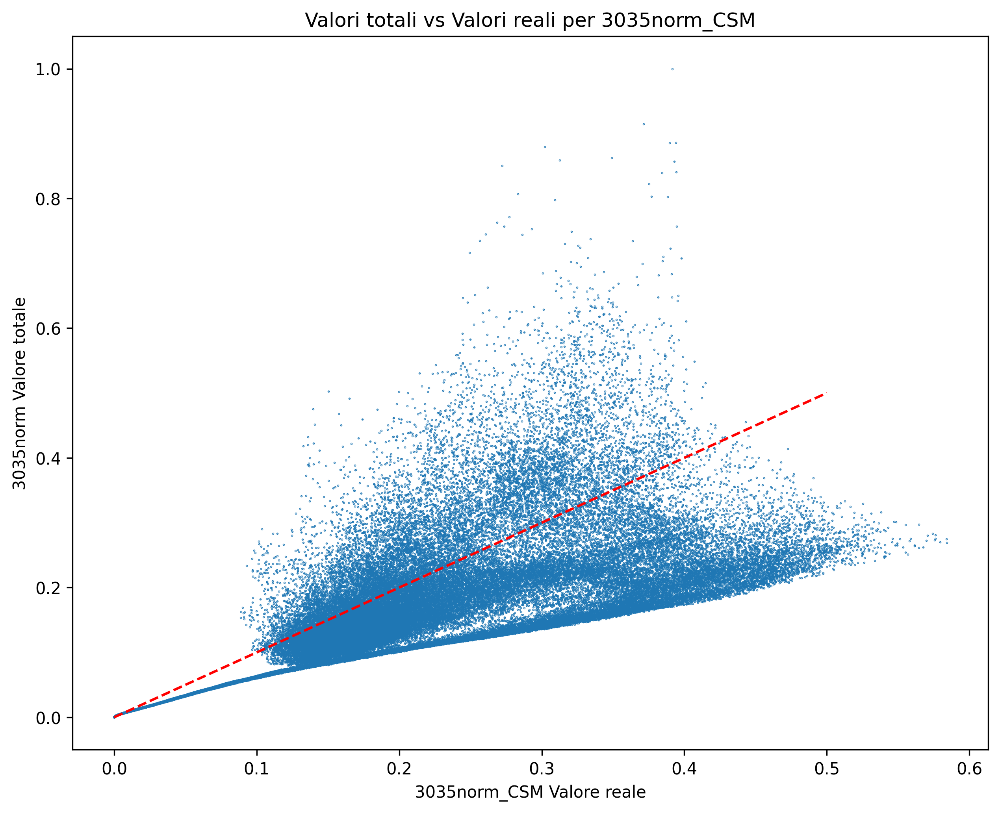

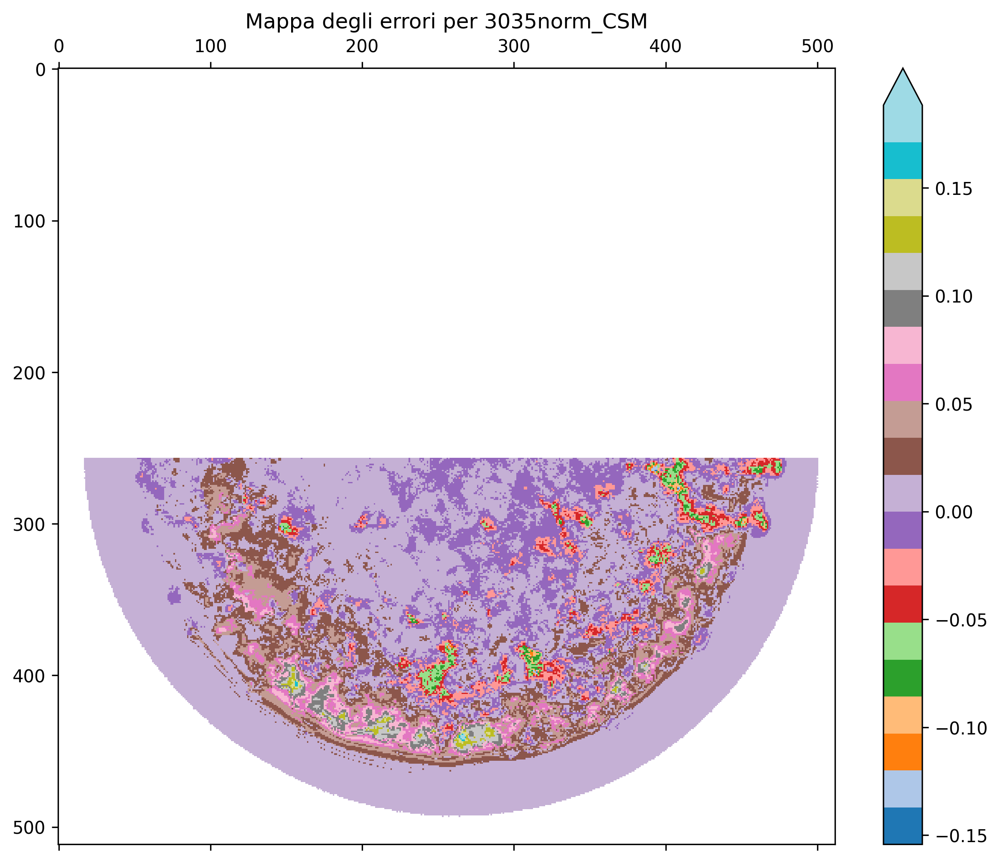

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 3540norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.695317  0.017770
3540norm_Total                  0.221312  0.003765
5060norm_Total                  0.032905  0.018702
4050norm_Total                  0.012179  0.007927
2130norm_Total                  0.011266  0.001124
0512norm_Total                  0.009091  0.000468
1621norm_Total                  0.003806  0.001216
3035norm_Total                  0.002586  0.000493
7080norm_haar_2y_4_flip         0.002447  0.000900
7080norm_haar_2x_8              0.002347  0.000971
7080norm_haar_2x_7              0.001977  0.000873
6070norm_Total                  0.001452  0.000919
1216norm_Total                  0.001152  0.000183
2130norm_haralick_r4_mean_f3    0.001

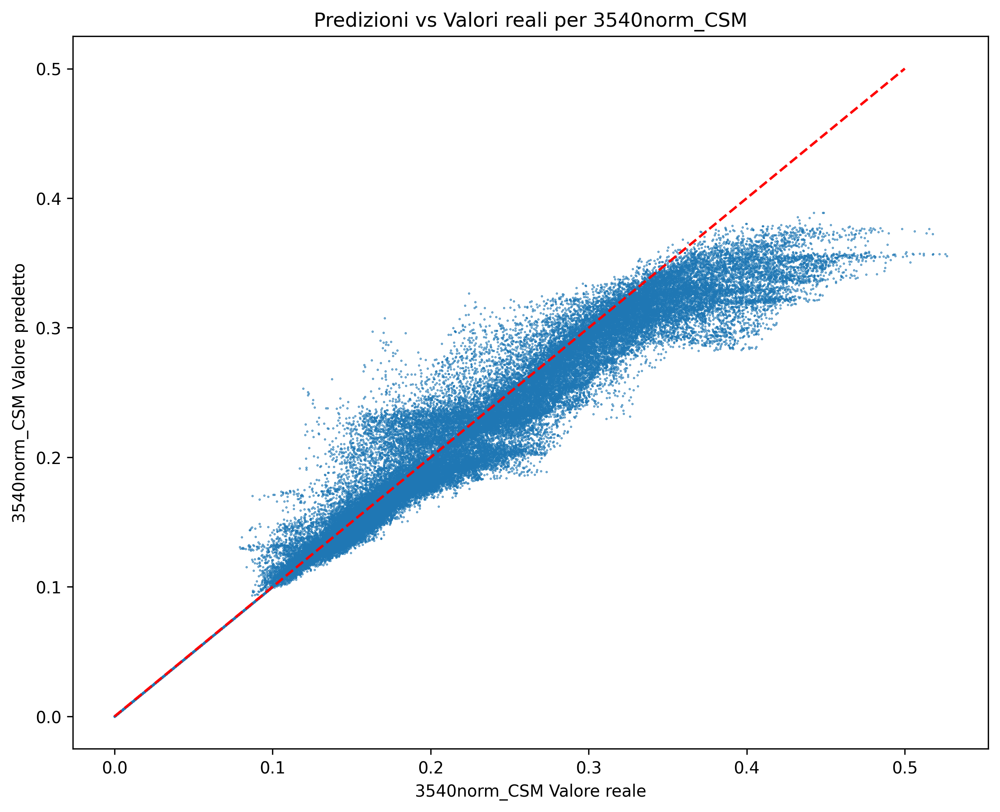

Statistiche              Valore
-------------------------------
Media:                 0.007594
Deviazione Standard:   0.021979
Skewness:              1.101235
Kurtosis:              5.722967
Mediana:               0.002366
25° Percentile:       -0.000005
75° Percentile:        0.012865
IQR:                   0.012870
Valore Minimo:        -0.136736
Valore Massimo:        0.170962


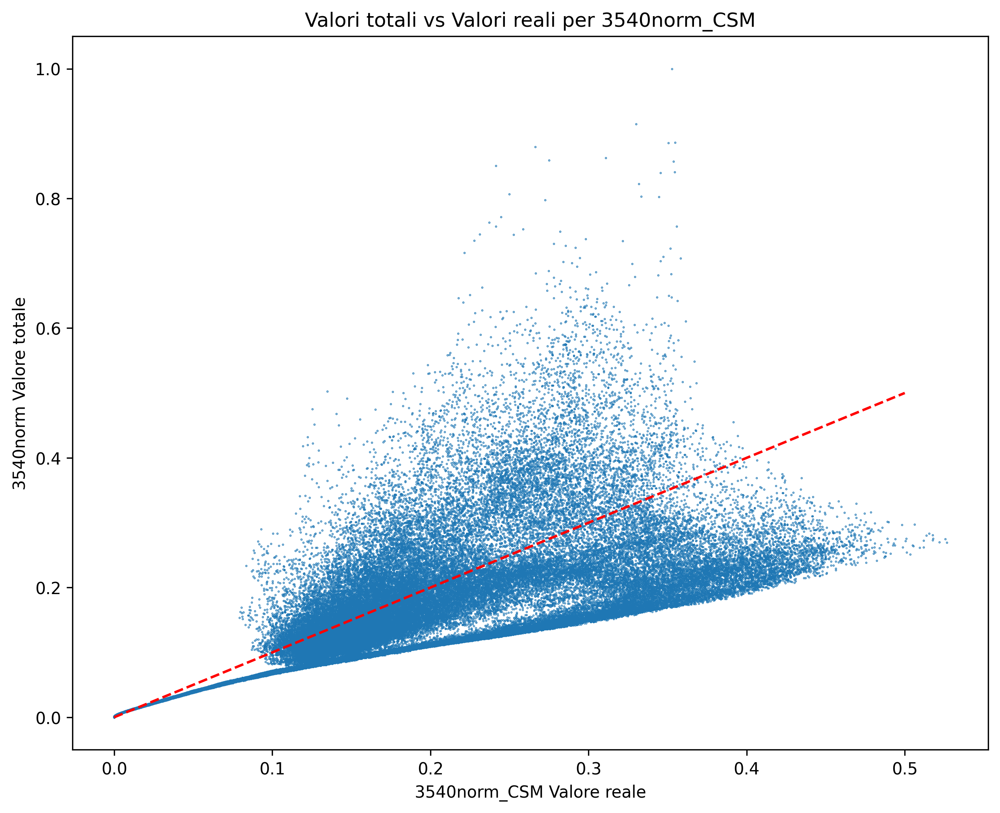

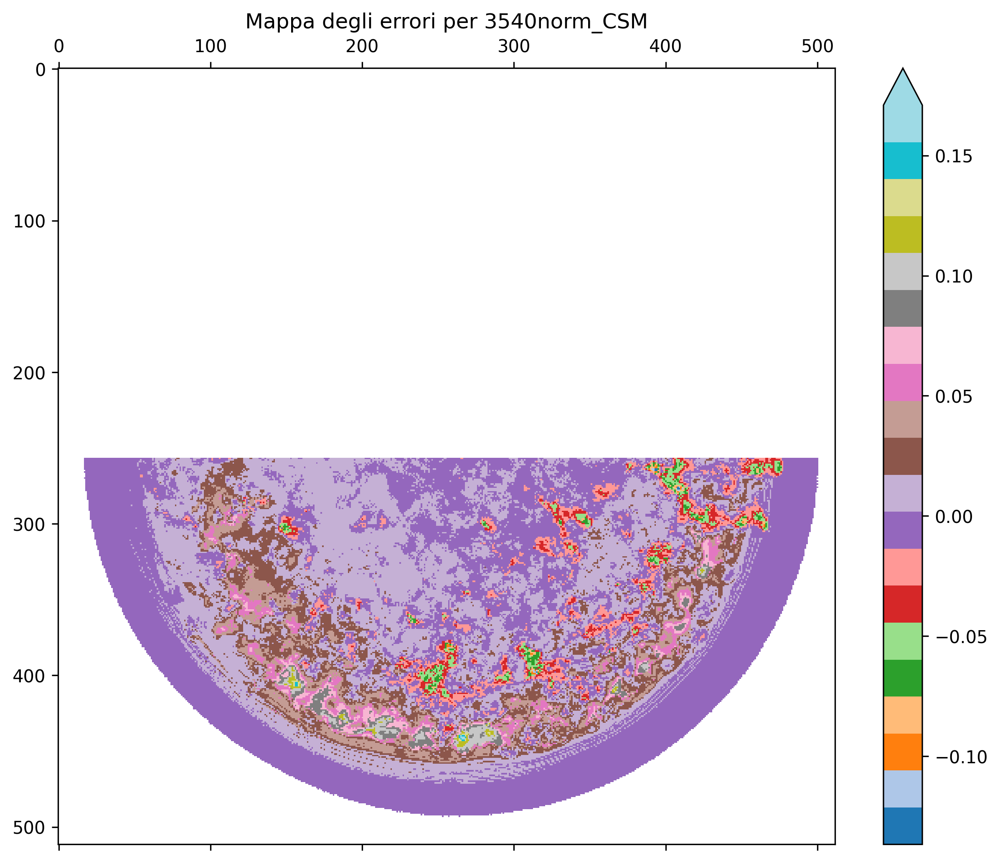

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 4050norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.704148  0.005180
4050norm_Total                  0.224708  0.004052
5060norm_Total                  0.025945  0.002028
2130norm_Total                  0.009805  0.001538
0512norm_Total                  0.009064  0.000337
3540norm_Total                  0.007046  0.001133
1621norm_Total                  0.005916  0.001472
7080norm_haar_2x_7              0.002427  0.001000
7080norm_haar_2y_4_flip         0.002395  0.000761
3035norm_Total                  0.002055  0.000243
7080norm_haar_2x_8              0.001901  0.000708
6070norm_Total                  0.001296  0.000432
1216norm_Total                  0.001286  0.000204
2130norm_haralick_r4_mean_f3    0.001

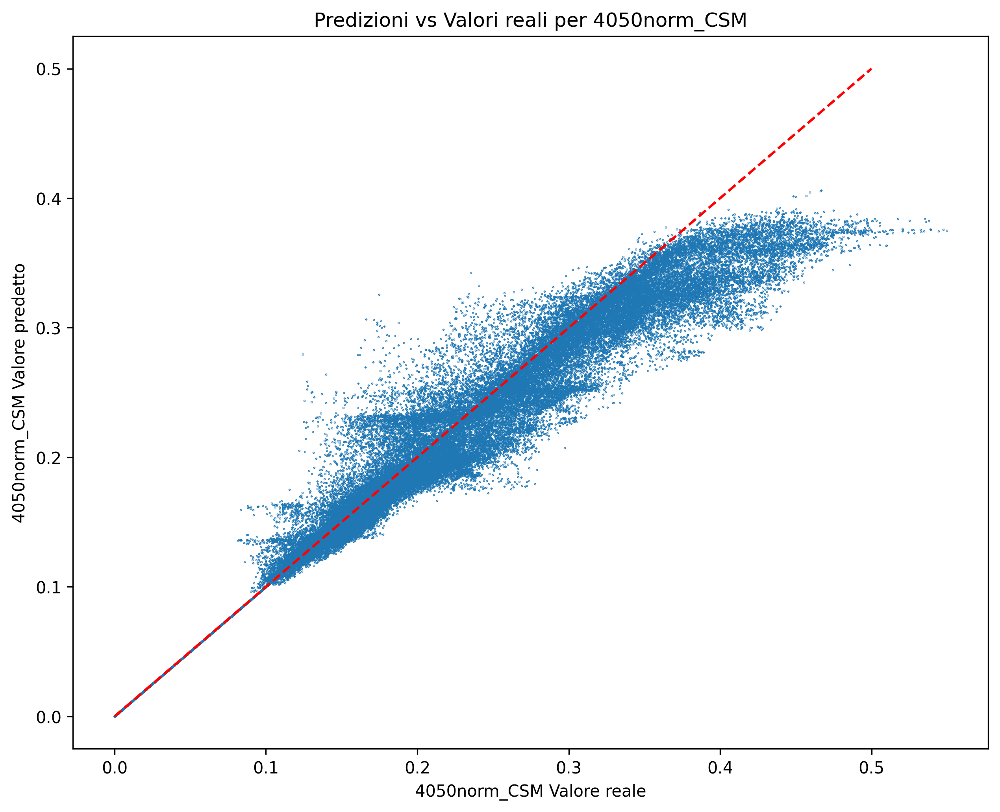

Statistiche              Valore
-------------------------------
Media:                 0.008490
Deviazione Standard:   0.023384
Skewness:              1.019516
Kurtosis:              4.898154
Mediana:               0.002674
25° Percentile:       -0.000004
75° Percentile:        0.013755
IQR:                   0.013759
Valore Minimo:        -0.155348
Valore Massimo:        0.174651


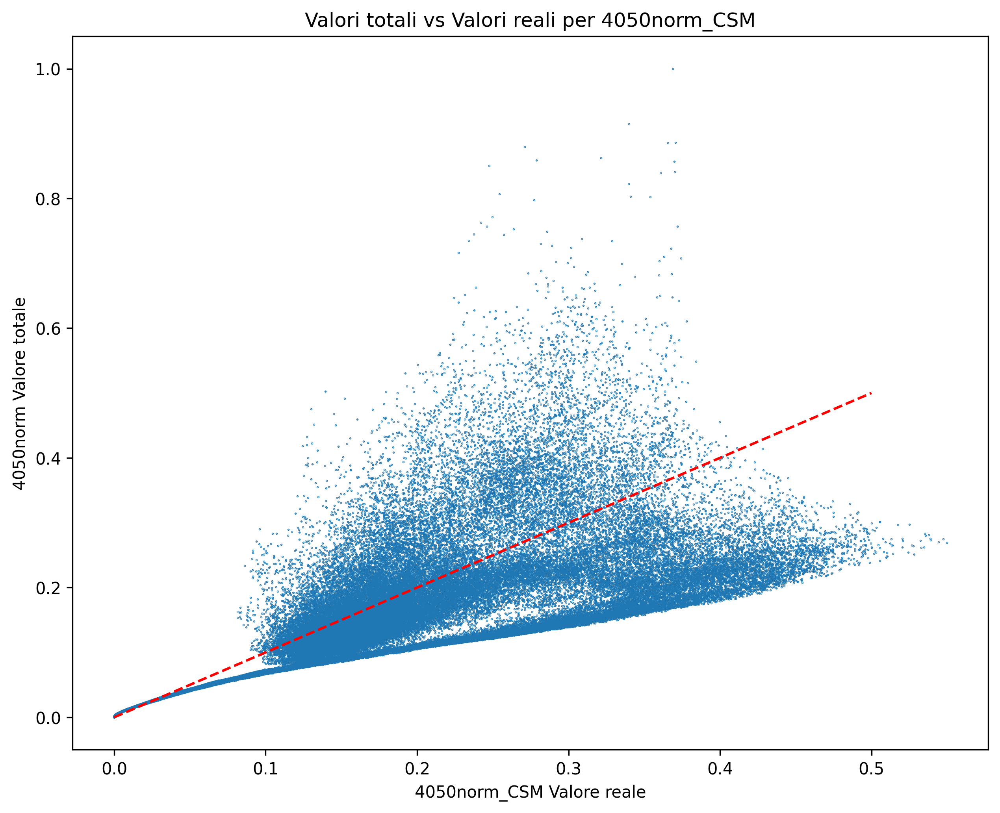

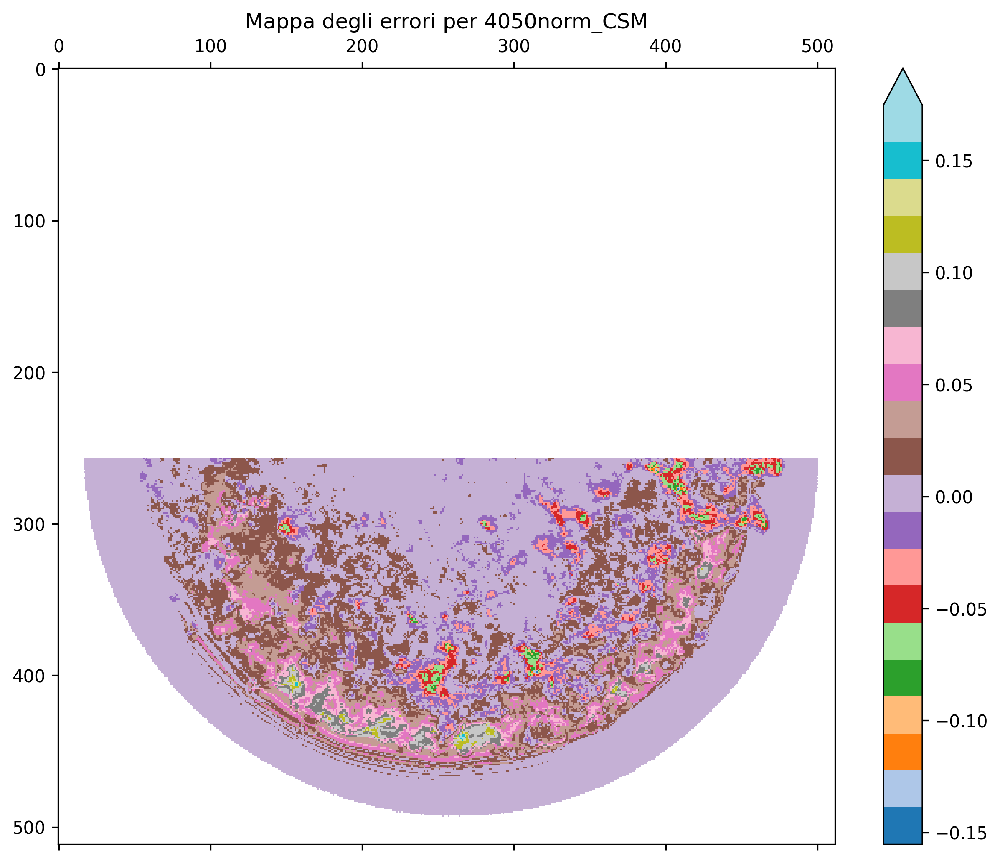

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 5060norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.709224  0.005244
5060norm_Total                  0.236022  0.004870
4050norm_Total                  0.010123  0.001301
0512norm_Total                  0.009926  0.000471
2130norm_Total                  0.009691  0.001270
1621norm_Total                  0.006710  0.001344
3540norm_Total                  0.006024  0.001076
7080norm_haar_2y_4_flip         0.002821  0.000580
7080norm_haar_2x_7              0.001794  0.000749
7080norm_haar_2x_8              0.001611  0.000558
3035norm_Total                  0.001514  0.000178
6070norm_Total                  0.001421  0.000593
1216norm_Total                  0.001343  0.000241
2130norm_haralick_r4_mean_f3    0.000

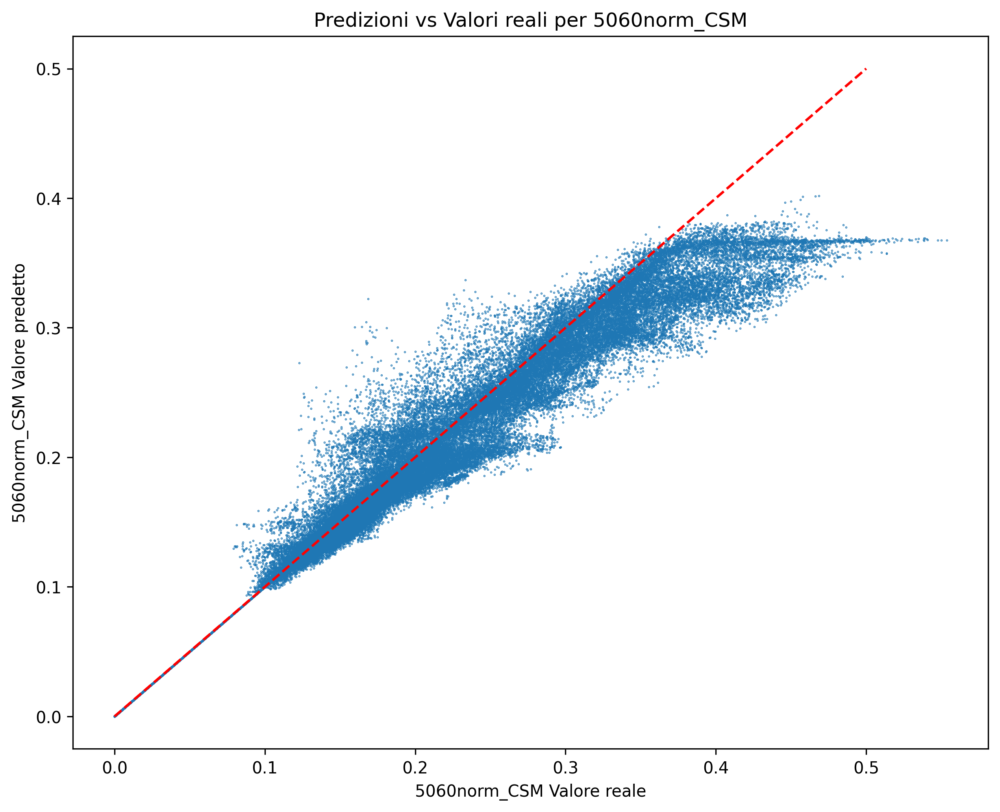

Statistiche              Valore
-------------------------------
Media:                 0.009131
Deviazione Standard:   0.023946
Skewness:              1.322373
Kurtosis:              5.538731
Mediana:               0.002796
25° Percentile:       -0.000003
75° Percentile:        0.013885
IQR:                   0.013888
Valore Minimo:        -0.153375
Valore Massimo:        0.186115


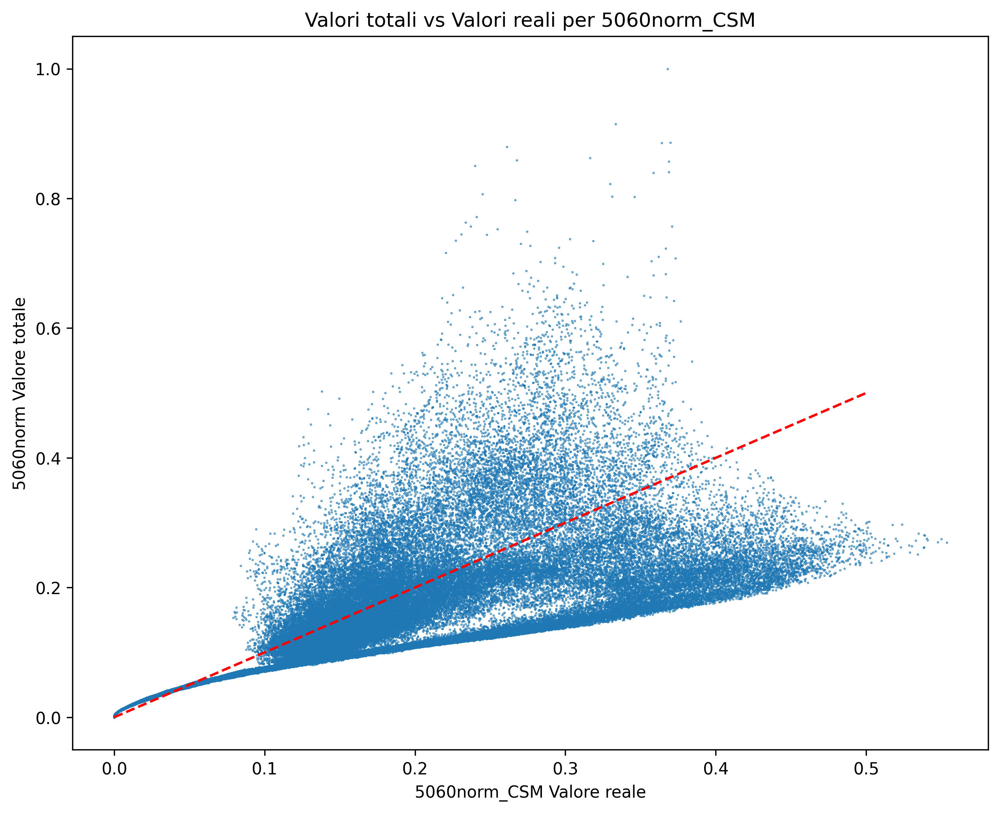

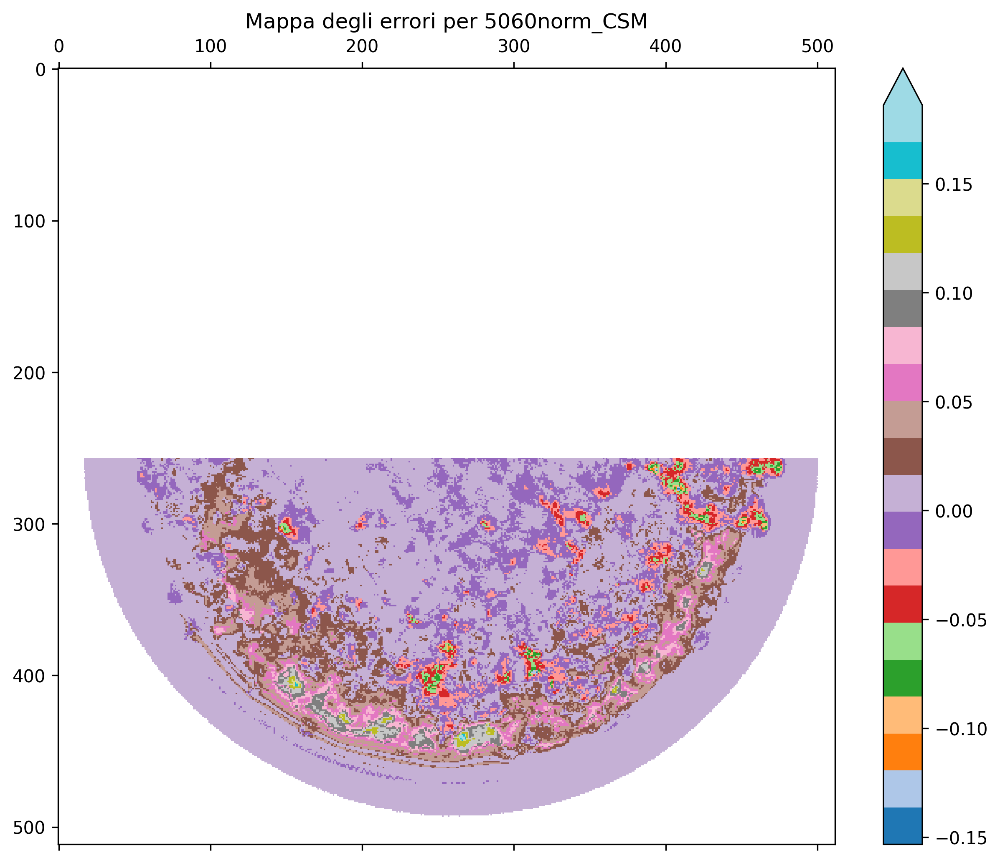

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 6070norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.717802  0.005350
6070norm_Total                  0.212143  0.008459
5060norm_Total                  0.020690  0.008085
0512norm_Total                  0.010680  0.000409
2130norm_Total                  0.010355  0.001888
4050norm_Total                  0.010157  0.001468
1621norm_Total                  0.005585  0.001871
3540norm_Total                  0.002851  0.000778
7080norm_haar_2y_4_flip         0.002595  0.000548
7080norm_haar_2x_7              0.001582  0.000491
7080norm_haar_2x_8              0.001545  0.000490
3035norm_Total                  0.001310  0.000146
1216norm_Total                  0.001184  0.000289
2130norm_haralick_r4_mean_f3    0.000

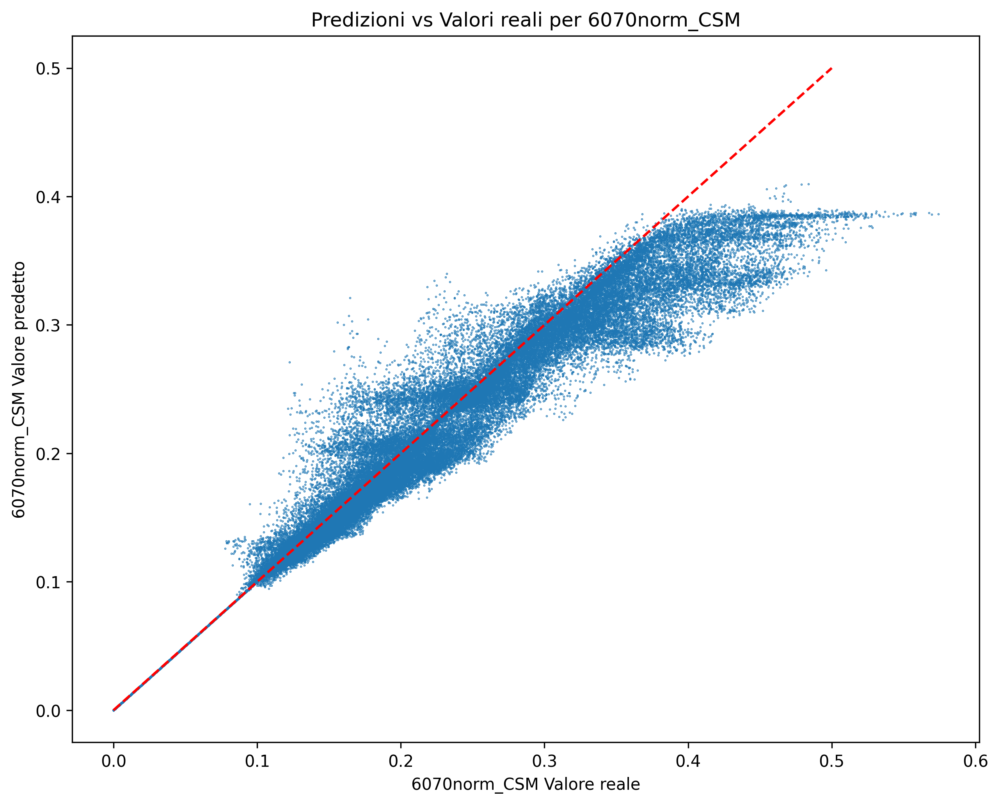

Statistiche              Valore
-------------------------------
Media:                 0.008577
Deviazione Standard:   0.024343
Skewness:              1.364712
Kurtosis:              6.198433
Mediana:               0.002539
25° Percentile:       -0.000004
75° Percentile:        0.013117
IQR:                   0.013121
Valore Minimo:        -0.156555
Valore Massimo:        0.187676


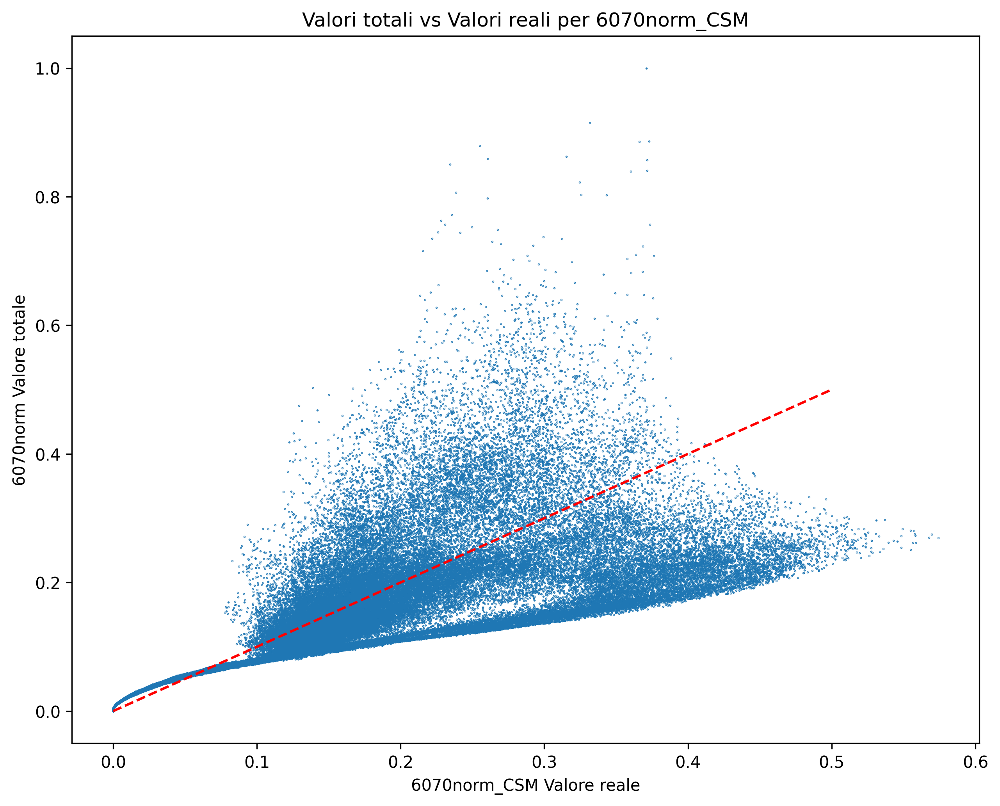

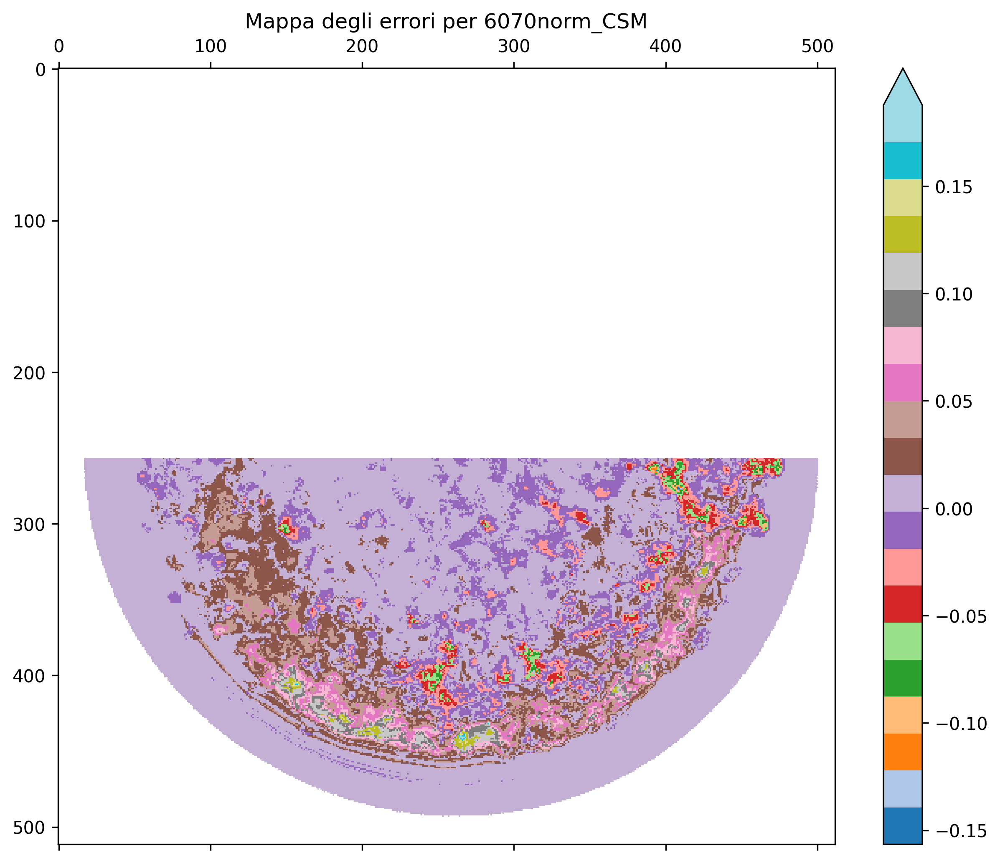

<IPython.core.display.Latex object>

********************************************************************************

Inizio Analisi per 7080norm_CSM

********************************************************************************


                              importance       std
feature                                           
7080norm_Total                  0.936699  0.005991
2130norm_Total                  0.011222  0.002026
0512norm_Total                  0.011035  0.001009
4050norm_Total                  0.008931  0.001707
1621norm_Total                  0.007770  0.002183
5060norm_Total                  0.007514  0.004408
6070norm_Total                  0.004594  0.004773
7080norm_haar_2y_4_flip         0.002781  0.000627
7080norm_haar_2x_7              0.001872  0.000700
3540norm_Total                  0.001666  0.000351
7080norm_haar_2x_8              0.001603  0.000557
1216norm_Total                  0.001563  0.000680
3035norm_Total                  0.001149  0.000148
2130norm_haralick_r4_mean_f3    0.000

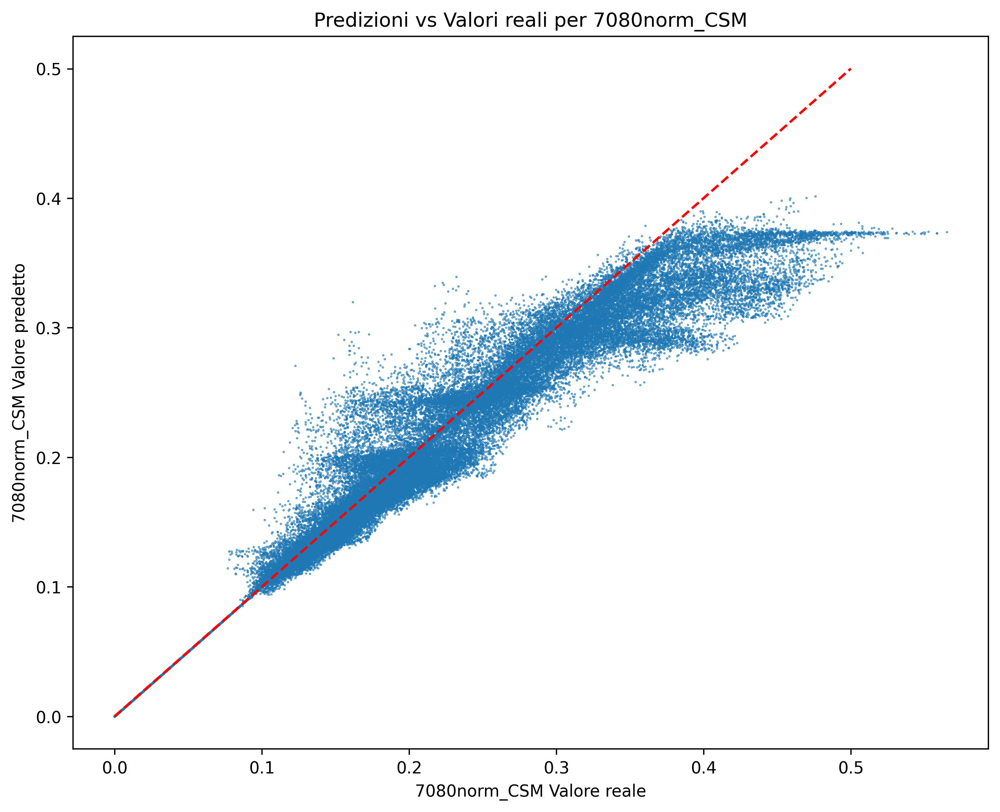

Statistiche              Valore
-------------------------------
Media:                 0.008753
Deviazione Standard:   0.025420
Skewness:              1.422953
Kurtosis:              6.254981
Mediana:               0.002430
25° Percentile:       -0.000008
75° Percentile:        0.013458
IQR:                   0.013466
Valore Minimo:        -0.157973
Valore Massimo:        0.191263


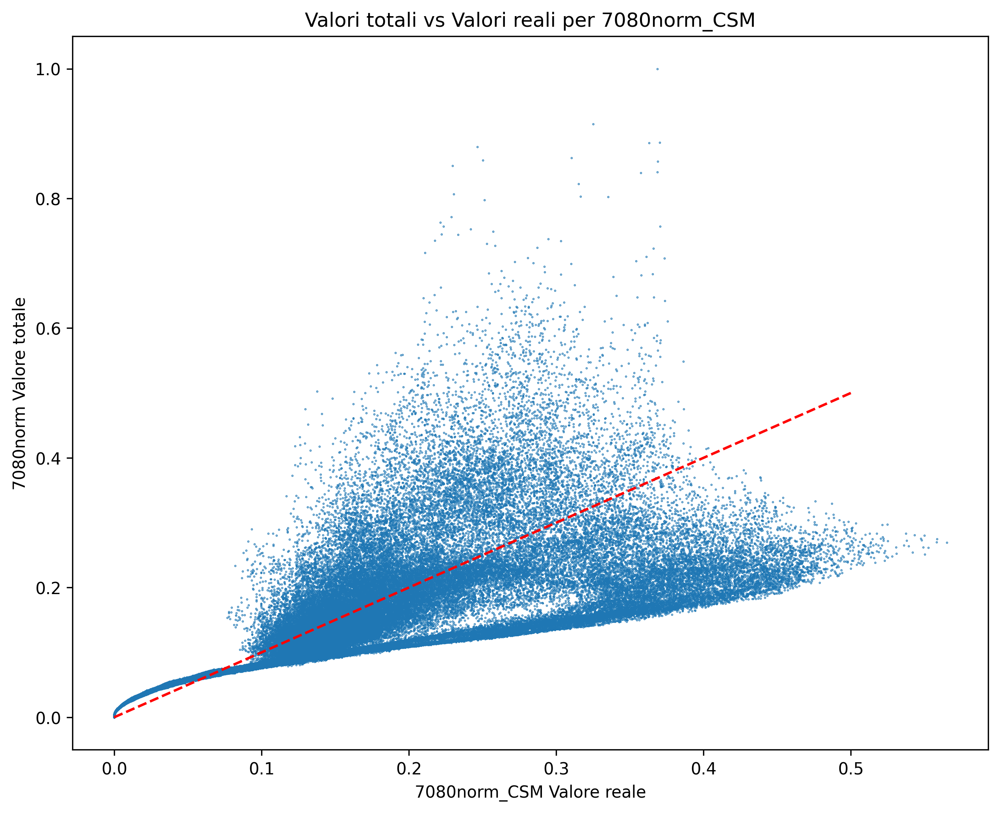

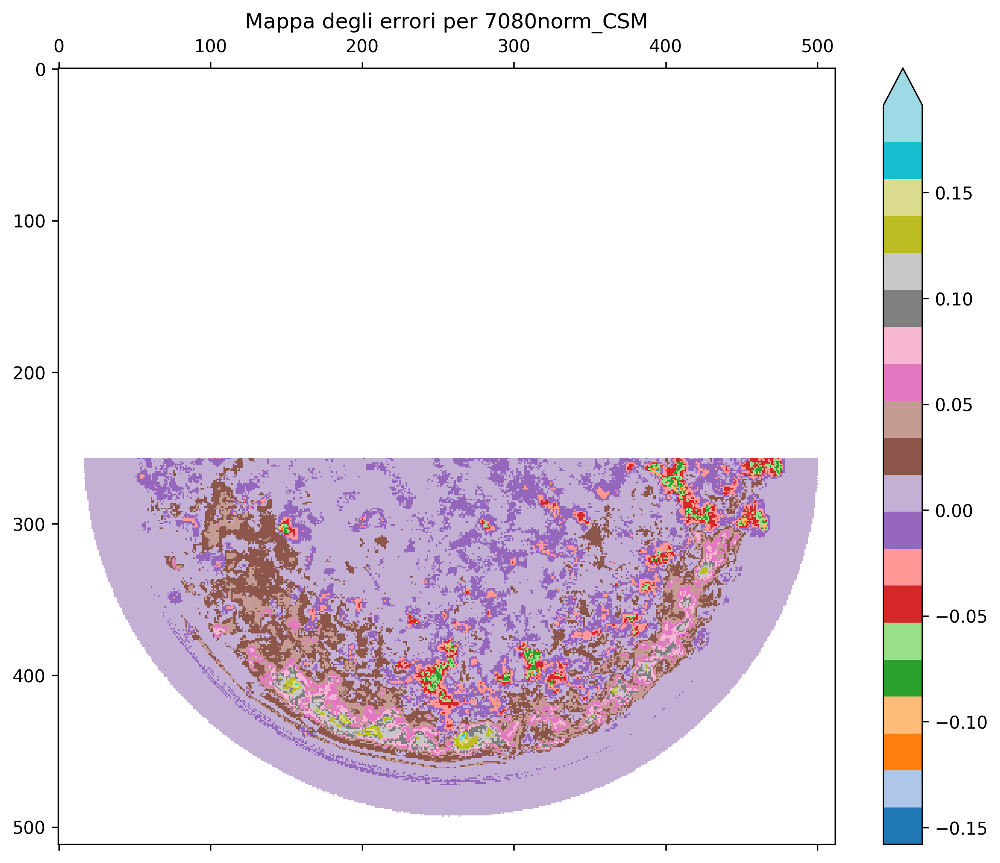

<IPython.core.display.Latex object>

In [81]:
# Main Loop: Iterate through all detected bands and targets

start_ttime = time.time()
display(Latex(r"\setcounter{page}{0}"))

for band in bands:
    # Set target type based on filename suffix
    if 'CSM' in fname:
        target = ['CSM']
    elif 'Ejecta' in fname:
        target = ['Ejecta']
    else:
        target = ['CSM', 'Ejecta']

    for target_type in target:
        col_target = f"{band}_{target_type}"
        if col_target in dictEx:
            display(Latex(r"\newpage"))

            print(80*"*"+"\n")
            print(f"Starting Analysis for {col_target}")
            print("\n"+80*"*"+"\n\n")
            
            # Extract target data
                                                                                                        
            y_total = fulldata[col_target].to_numpy()
            
            # Data splitting for target variable
            mid = int(y_total.shape[0] / 2)
            delta = 512
            y_train = y_total[:mid-delta][maskTotBol[:mid-delta]]
            y_test = y_total[mid+delta:][maskTotBol[mid+delta:]]
            
            # Run the analytical pipeline
            train_and_analyze(Xtrain, Xtest, y_train, y_test, col_target)
        else:
            print(f"Column {col_target} not found in the dataset.")

                                                                                                           
display(Latex(r"\newpage"))